In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Patch
from matplotlib.lines import Line2D
sns.set_style('whitegrid')
sns.set_context('talk', font_scale=1.5)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 100)

output_path = '../results/simulations/2025_figures'

In [2]:
boot_df_name = '../results/20250221_big_table_bootstrap.csv'

In [3]:
sub_df = pd.read_csv(boot_df_name, sep='\t', nrows=1000*26)

In [4]:
sub_cols = sub_df.columns.to_list()[:13]
header=sub_df.columns

/Users/JudithAbecassis/miniconda3/envs/new_causal_37/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


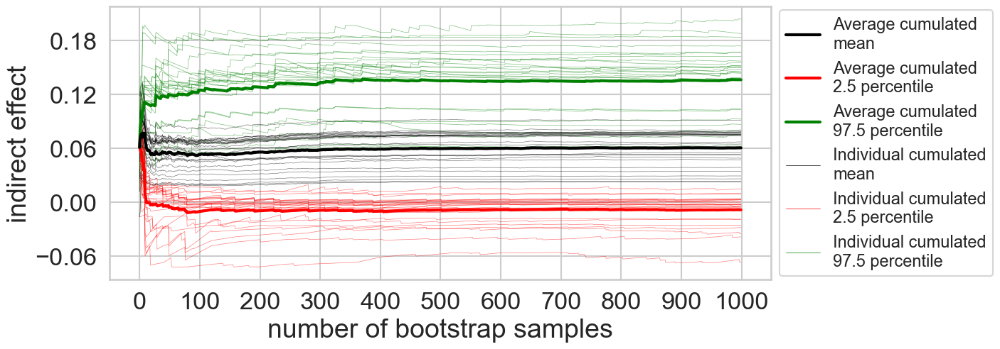

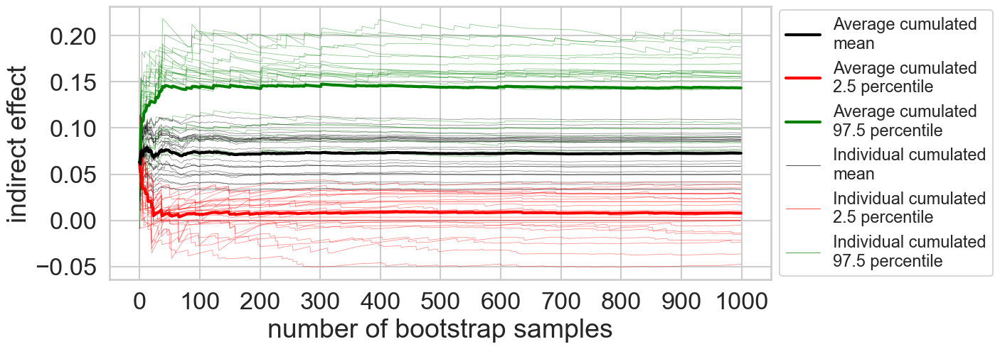

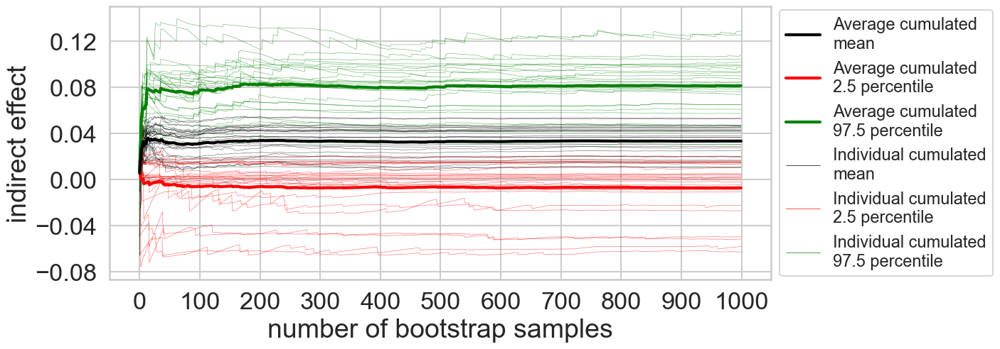

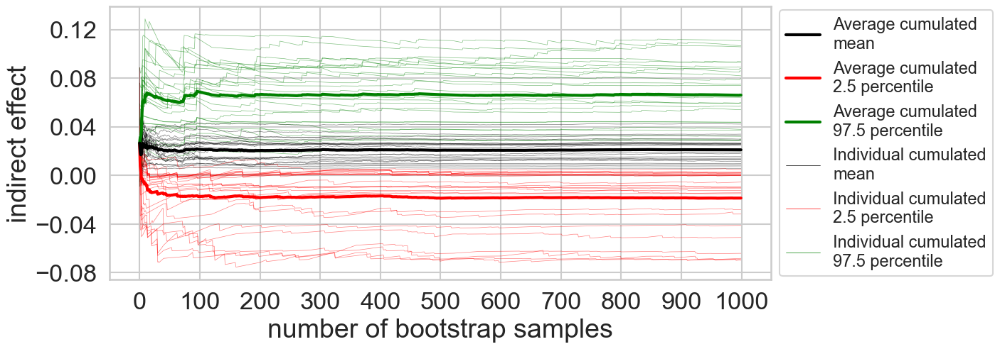

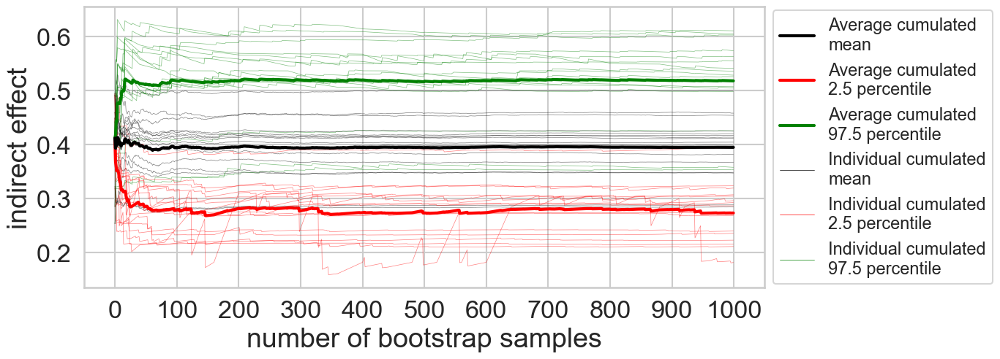

...

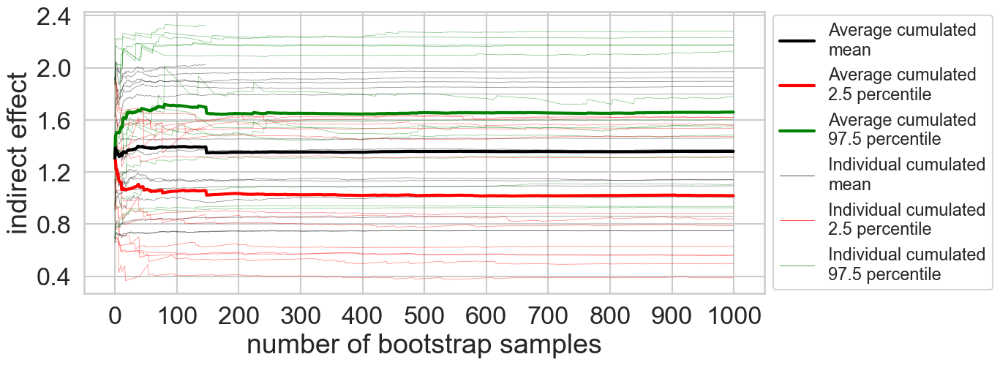

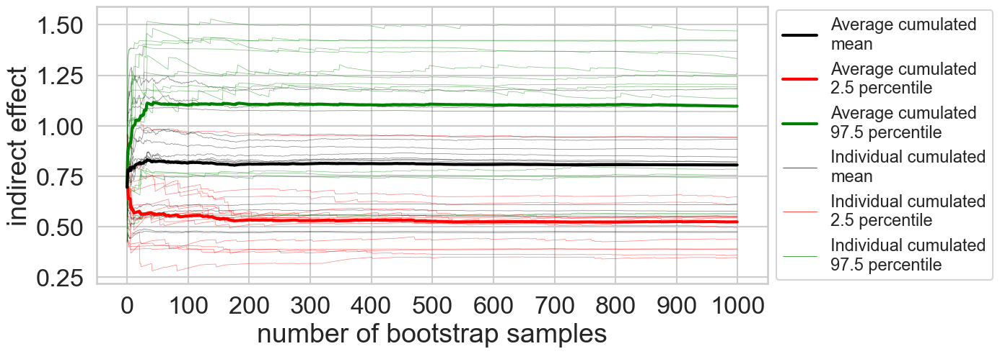

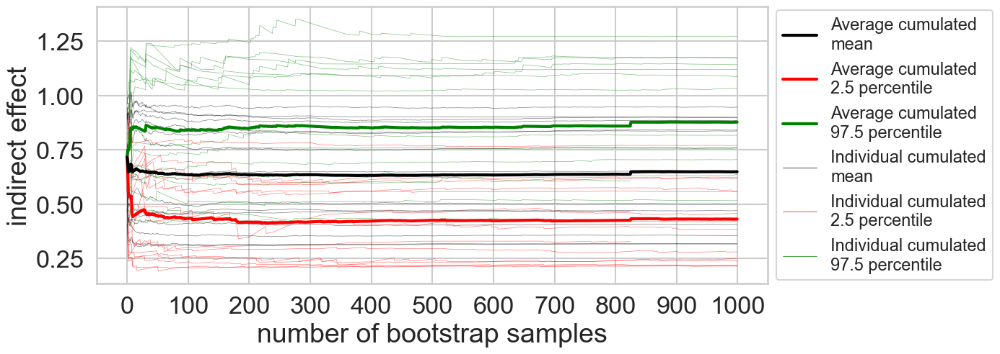

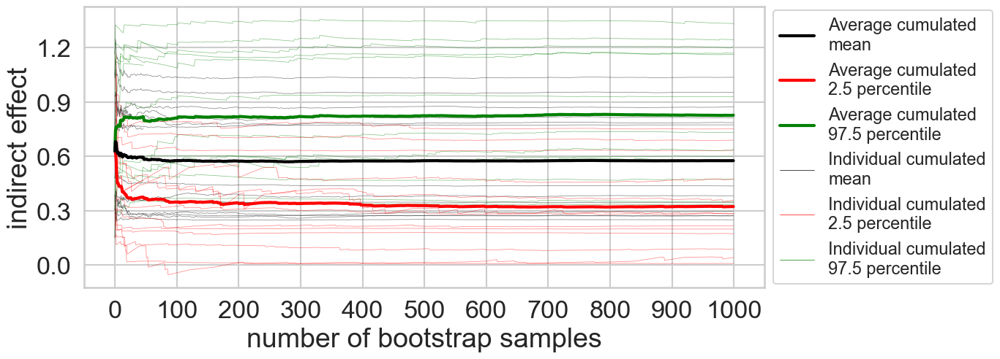

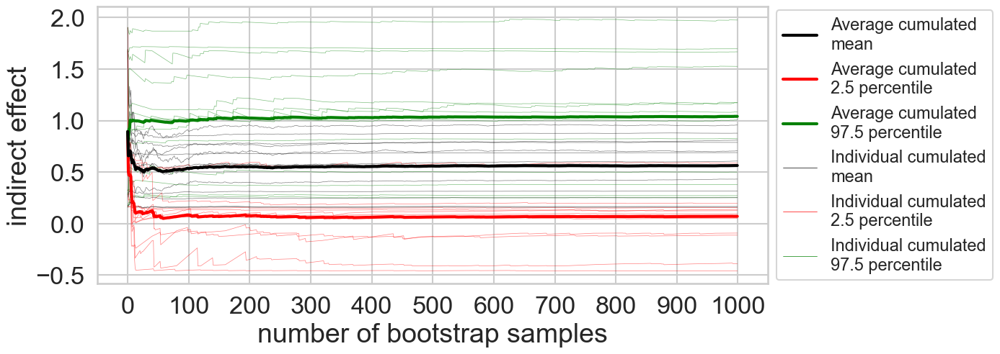

In [13]:
letters = 'abcd'
for idx in [5, 28, 45, 62]:
    sub_df = pd.read_csv(boot_df_name, sep='\t', nrows=1000*26, skiprows=1000*idx*26, names=header, header=0)
    if len(sub_df.drop_duplicates(subset=sub_cols))>=2:
        print(idx, 'problem')
        break
    num_bootstrap_samples = 1000
    max_disp = 1000
    fig, ax = plt.subplots(figsize=(12,5))
    big_p_05s = list()
    big_p_95s = list()
    big_means = list()
    for estim in sub_df.estimator.unique():
        #estim='mediation_DML_noreg'
        sub_sub_df = sub_df[sub_df.estimator==estim]
        #for effect in ['total_effect', 'direct_control_effect', 'indirect_treated_effect']:
        effect = 'indirect_treated_effect'
        all_atts = sub_sub_df[effect].values
        p_05s = [np.percentile(all_atts[0:x+1], 2.5) for x in range(0, num_bootstrap_samples)]
        p_95s = [np.percentile(all_atts[0:x+1], 97.5) for x in range(0, num_bootstrap_samples)]
        means = [np.mean(all_atts[0:x+1]) for x in range(0, num_bootstrap_samples)]

        # See how much each statistic changes with the newly added sample
        pd_p_05s = [0] + [np.abs((p_05s[x]-p_05s[x-1])/p_05s[x-1]) for x in range(1, num_bootstrap_samples)]
        pd_p_95s = [0] + [np.abs((p_95s[x]-p_95s[x-1])/p_95s[x-1]) for x in range(1, num_bootstrap_samples)]
        pd_means = [0] + [np.abs((means[x]-means[x-1])/means[x-1]) for x in range(1, num_bootstrap_samples)]
        big_p_05s.append(p_05s)
        big_p_95s.append(p_95s)
        big_means.append(means)
        ax.plot(list(range(max_disp)), p_05s[:max_disp], color='red', alpha = 0.5, lw=0.5)
        ax.plot(list(range(max_disp)), p_95s[:max_disp], color='green', alpha = 0.5, lw=0.5)
        ax.plot(list(range(max_disp)), means[:max_disp], color='black', alpha = 0.5, lw=0.5)
    ax.plot(list(range(max_disp)),  np.nanmean(np.array(big_p_05s),axis=0)[:max_disp], color='red', lw=3)
    ax.plot(list(range(max_disp)),  np.nanmean(np.array(big_p_95s),axis=0)[:max_disp], color='green', lw=3)
    ax.plot(list(range(max_disp)), np.nanmean(np.array(big_means),axis=0)[:max_disp], color='black', lw=3)
    title = 'n_{}_typeM_{}_wt_{}_wm_{}_missM_{}_missY_{}'.format(sub_df.iloc[0]['n'],
                                                                          sub_df.iloc[0]['type_m'],
                                                                          sub_df.iloc[0]['wt_list'],
                                                                          sub_df.iloc[0]['wm_list'],
                                                                          sub_df.iloc[0]['m_misspec'],
                                                                          sub_df.iloc[0]['y_misspec'])
    #ax.set_title('')
    ax.set_xlabel('number of bootstrap samples')
    ax.set_ylabel('indirect effect')
    
    legend_elements = [Line2D([0], [0], color='black', lw=3, label='Average cumulated\nmean'),
                       Line2D([0], [0], color='red', lw=3, label='Average cumulated\n2.5 percentile'),
                       Line2D([0], [0], color='green', lw=3, label='Average cumulated\n97.5 percentile'),
                       Line2D([0], [0], color='black', lw=0.5, label='Individual cumulated\nmean'),
                       Line2D([0], [0], color='red', lw=0.5, label='Individual cumulated\n2.5 percentile'),
                       Line2D([0], [0], color='green', lw=0.5, label='Individual cumulated\n97.5 percentile'),]
    ax.legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 17})
    ax.xaxis.set_major_locator(plt.MaxNLocator(11))
    ax.yaxis.set_major_locator(plt.MaxNLocator(6))
    plt.savefig(output_path+'/new_special_bootstrap_{}_{}.pdf'.format(idx,title) , bbox_inches='tight')

0 n_500_typeM_continuous_wt_0.5_wm_0.5_missM_False_missY_True
1 n_500_typeM_continuous_wt_2.0_wm_1.0_missM_True_missY_True
2 n_1000_typeM_continuous_wt_0.2_wm_0.2_missM_False_missY_True
3 n_1000_typeM_binary_wt_4.0_wm_2.0_missM_True_missY_False


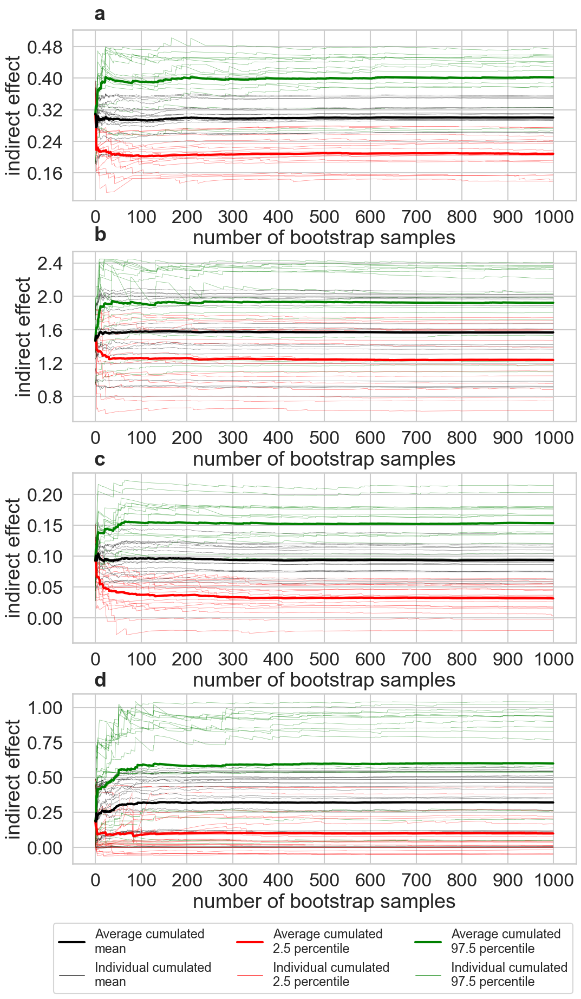

In [24]:
#extra.append(ax.text(-1.1, ax.get_ylim()[1]*1.05, letters[cov_idx*2], weight='bold'))
fig, ax = plt.subplots(4, 1, figsize=(12,20))
letters = 'abcd'
for iii, idx in enumerate([5, 28, 45, 62]):
    sub_df = pd.read_csv(boot_df_name, sep='\t', nrows=1000*26, skiprows=1000*idx*26, names=header, header=0)
    if len(sub_df.drop_duplicates(subset=sub_cols))>=2:
        print(idx, 'problem')
        break
    num_bootstrap_samples = 1000
    max_disp = 1000
    
    big_p_05s = list()
    big_p_95s = list()
    big_means = list()
    for estim in sub_df.estimator.unique():
        #estim='mediation_DML_noreg'
        sub_sub_df = sub_df[sub_df.estimator==estim]
        #for effect in ['total_effect', 'direct_control_effect', 'indirect_treated_effect']:
        effect = 'indirect_treated_effect'
        all_atts = sub_sub_df[effect].values
        p_05s = [np.percentile(all_atts[0:x+1], 2.5) for x in range(0, num_bootstrap_samples)]
        p_95s = [np.percentile(all_atts[0:x+1], 97.5) for x in range(0, num_bootstrap_samples)]
        means = [np.mean(all_atts[0:x+1]) for x in range(0, num_bootstrap_samples)]

        # See how much each statistic changes with the newly added sample
        pd_p_05s = [0] + [np.abs((p_05s[x]-p_05s[x-1])/p_05s[x-1]) for x in range(1, num_bootstrap_samples)]
        pd_p_95s = [0] + [np.abs((p_95s[x]-p_95s[x-1])/p_95s[x-1]) for x in range(1, num_bootstrap_samples)]
        pd_means = [0] + [np.abs((means[x]-means[x-1])/means[x-1]) for x in range(1, num_bootstrap_samples)]
        big_p_05s.append(p_05s)
        big_p_95s.append(p_95s)
        big_means.append(means)
        ax[iii].plot(list(range(max_disp)), p_05s[:max_disp], color='red', alpha = 0.5, lw=0.5)
        ax[iii].plot(list(range(max_disp)), p_95s[:max_disp], color='green', alpha = 0.5, lw=0.5)
        ax[iii].plot(list(range(max_disp)), means[:max_disp], color='black', alpha = 0.5, lw=0.5)
    ax[iii].plot(list(range(max_disp)),  np.nanmean(np.array(big_p_05s),axis=0)[:max_disp], color='red', lw=3)
    ax[iii].plot(list(range(max_disp)),  np.nanmean(np.array(big_p_95s),axis=0)[:max_disp], color='green', lw=3)
    ax[iii].plot(list(range(max_disp)), np.nanmean(np.array(big_means),axis=0)[:max_disp], color='black', lw=3)
    title = 'n_{}_typeM_{}_wt_{}_wm_{}_missM_{}_missY_{}'.format(sub_df.iloc[0]['n'],
                                                                          sub_df.iloc[0]['type_m'],
                                                                          sub_df.iloc[0]['wt_list'],
                                                                          sub_df.iloc[0]['wm_list'],
                                                                          sub_df.iloc[0]['m_misspec'],
                                                                          sub_df.iloc[0]['y_misspec'])
    #ax.set_title('')
    ax[iii].set_xlabel('number of bootstrap samples')
    ax[iii].set_ylabel('indirect effect')
    if iii==3:
        legend_elements = [Line2D([0], [0], color='black', lw=3, label='Average cumulated\nmean'),
                           Line2D([0], [0], color='black', lw=0.5, label='Individual cumulated\nmean'),
                           Line2D([0], [0], color='red', lw=3, label='Average cumulated\n2.5 percentile'),
                           Line2D([0], [0], color='red', lw=0.5, label='Individual cumulated\n2.5 percentile'),
                           Line2D([0], [0], color='green', lw=3, label='Average cumulated\n97.5 percentile'),
                           Line2D([0], [0], color='green', lw=0.5, label='Individual cumulated\n97.5 percentile'),]
        ax[iii].legend(handles=legend_elements, loc='lower left', bbox_to_anchor=(-0.05, -0.8), prop={'size': 17}, ncol=3)
    ax[iii].xaxis.set_major_locator(plt.MaxNLocator(11))
    ax[iii].yaxis.set_major_locator(plt.MaxNLocator(6))
    ax[iii].text(-3.1, ax[iii].get_ylim()[1]*1.05, letters[iii], weight='bold')
    print(iii, title)
    plt.subplots_adjust(hspace=0.3, wspace=0)
plt.savefig(output_path+'/summary_bootstrap.pdf', bbox_inches='tight')

In [17]:
ax.shape

(4,)

In [31]:
sub_df = pd.read_csv(boot_df_name, sep='\t', nrows=1000*26*3)

In [37]:
sub_df[1000*26*2:1000*26*3]

,n,dim_x,dim_m,type_m,wt_list,wm_list,m_misspec,y_misspec,mediated_prop,total,direct_1,direct_0,indirect_1,indirect_0,estimator,total_effect,direct_treated_effect,direct_control_effect,indirect_treated_effect,indirect_control_effect,duration,boot_idx,timestamp
52000,500,5,1,binary,0.5,0.5,True,False,0.022629,1.227784,1.2,1.2,0.027784,0.027784,coefficient_product,1.230344,1.207546,1.207546,0.022798,0.022798,0.029320,0.0,1.739846e+09
52001,500,5,1,binary,0.5,0.5,True,False,0.022629,1.227784,1.2,1.2,0.027784,0.027784,mediation_ipw_noreg,1.215186,1.191384,1.199057,0.016129,0.023802,0.053459,0.0,1.739846e+09
52002,500,5,1,binary,0.5,0.5,True,False,0.022629,1.227784,1.2,1.2,0.027784,0.027784,mediation_ipw_reg,1.250225,1.245922,1.246607,0.003618,0.004302,0.253572,0.0,1.739846e+09
52003,500,5,1,binary,0.5,0.5,True,False,0.022629,1.227784,1.2,1.2,0.027784,0.027784,mediation_ipw_forest,1.240565,1.238901,1.240816,-0.000250,0.001664,0.505305,0.0,1.739846e+09
52004,500,5,1,binary,0.5,0.5,True,False,0.022629,1.227784,1.2,1.2,0.027784,0.027784,mediation_ipw_reg_cf,1.210958,1.205011,1.207500,0.003458,0.005946,0.483863,0.0,1.739846e+09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77995,500,5,1,binary,0.5,0.5,True,False,0.022629,1.227784,1.2,1.2,0.027784,0.027784,mediation_DML_noreg,1.187550,1.171016,1.175568,0.011982,0.016533,0.151909,999.0,1.739846e+09
77996,500,5,1,binary,0.5,0.5,True,False,0.022629,1.227784,1.2,1.2,0.027784,0.027784,mediation_DML_reg,1.244536,1.230928,1.218667,0.025869,0.013608,0.736089,999.0,1.739846e+09
77997,500,5,1,binary,0.5,0.5,True,False,0.022629,1.227784,1.2,1.2,0.027784,0.027784,mediation_DML_reg_cf,1.241813,1.208769,1.193707,0.048106,0.033044,1.451590,999.0,1.739846e+09
77998,500,5,1,binary,0.5,0.5,True,False,0.022629,1.227784,1.2,1.2,0.027784,0.027784,mediation_DML_forest,1.216879,1.200632,1.204025,0.012854,0.016247,1.400683,999.0,1.739846e+09


In [16]:
header=sub_df.columns

In [17]:
sub_df_1000 = pd.read_csv(boot_df_name, sep='\t', nrows=1000*26, skiprows=1000*26*36, names=header, header=0)
sub_df_1000

,n,dim_x,dim_m,type_m,wt_list,wm_list,m_misspec,y_misspec,mediated_prop,total,direct_1,direct_0,indirect_1,indirect_0,estimator,total_effect,direct_treated_effect,direct_control_effect,indirect_treated_effect,indirect_control_effect,duration,boot_idx,timestamp
0,1000,5,1,binary,0.5,0.5,True,True,0.0537,1.53428,1.506816,1.451889,0.082391,0.027464,coefficient_product,1.531265,1.438276,1.438276,0.092989,0.092989,0.030095,0.0,1.739848e+09
1,1000,5,1,binary,0.5,0.5,True,True,0.0537,1.53428,1.506816,1.451889,0.082391,0.027464,mediation_ipw_noreg,1.534652,1.471714,1.405414,0.129237,0.062938,0.055285,0.0,1.739848e+09
2,1000,5,1,binary,0.5,0.5,True,True,0.0537,1.53428,1.506816,1.451889,0.082391,0.027464,mediation_ipw_reg,1.535352,1.465584,1.413084,0.122268,0.069767,0.261809,0.0,1.739848e+09
3,1000,5,1,binary,0.5,0.5,True,True,0.0537,1.53428,1.506816,1.451889,0.082391,0.027464,mediation_ipw_forest,1.540736,1.513873,1.448912,0.091824,0.026864,0.651027,0.0,1.739848e+09
4,1000,5,1,binary,0.5,0.5,True,True,0.0537,1.53428,1.506816,1.451889,0.082391,0.027464,mediation_ipw_reg_cf,1.541760,1.480763,1.413761,0.127999,0.060997,0.494889,0.0,1.739848e+09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25995,1000,5,1,binary,0.5,0.5,True,True,0.0537,1.53428,1.506816,1.451889,0.082391,0.027464,mediation_DML_noreg,1.552331,1.502096,1.439290,0.113041,0.050235,0.148415,999.0,1.739848e+09
25996,1000,5,1,binary,0.5,0.5,True,True,0.0537,1.53428,1.506816,1.451889,0.082391,0.027464,mediation_DML_reg,1.552753,1.534694,1.441644,0.111109,0.018059,0.717697,999.0,1.739848e+09
25997,1000,5,1,binary,0.5,0.5,True,True,0.0537,1.53428,1.506816,1.451889,0.082391,0.027464,mediation_DML_reg_cf,1.555970,1.510709,1.439594,0.116375,0.045261,1.407213,999.0,1.739848e+09
25998,1000,5,1,binary,0.5,0.5,True,True,0.0537,1.53428,1.506816,1.451889,0.082391,0.027464,mediation_DML_forest,1.545121,1.507132,1.426027,0.119094,0.037990,1.698879,999.0,1.739848e+09


In [18]:
num_bootstrap_samples = 1000
#for estim in sub_df.estimator.unique():
estim='mediation_DML_noreg'
sub_sub_df = sub_df_1000[sub_df_1000.estimator==estim]
for effect in ['total_effect', 'direct_control_effect', 'indirect_treated_effect']:
    all_atts = sub_sub_df[effect].values
    p_05s = [np.percentile(all_atts[0:x+1], 2.5) for x in range(0, num_bootstrap_samples)]
    p_95s = [np.percentile(all_atts[0:x+1], 97.5) for x in range(0, num_bootstrap_samples)]
    means = [np.mean(all_atts[0:x+1]) for x in range(0, num_bootstrap_samples)]

    # See how much each statistic changes with the newly added sample
    pd_p_05s = [0] + [np.abs((p_05s[x]-p_05s[x-1])/p_05s[x-1]) for x in range(1, num_bootstrap_samples)]
    pd_p_95s = [0] + [np.abs((p_95s[x]-p_95s[x-1])/p_95s[x-1]) for x in range(1, num_bootstrap_samples)]
    pd_means = [0] + [np.abs((means[x]-means[x-1])/means[x-1]) for x in range(1, num_bootstrap_samples)]

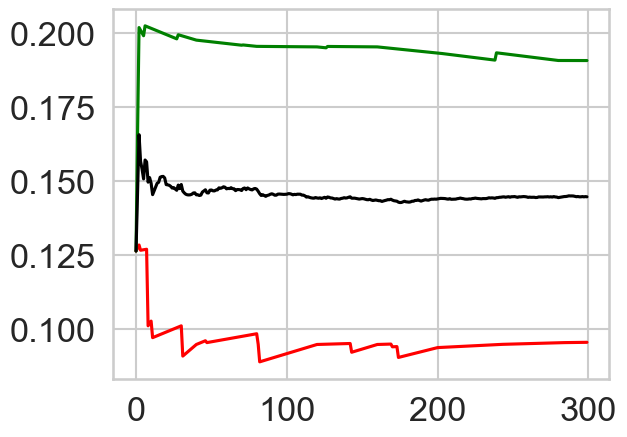

In [19]:
plt.plot(list(range(300)), p_05s[:300], color='red')
plt.plot(list(range(300)), p_95s[:300], color='green')
plt.plot(list(range(300)), means[:300], color='black')
ax = plt.gca()